<a href="https://colab.research.google.com/github/dgg32/ml_pycaret/blob/main/ml_with_pycaret_classification_intermedia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install pycaret

     |████████████████████████████████| 256kB 5.5MB/s 
     |████████████████████████████████| 276kB 10.5MB/s 
     |████████████████████████████████| 6.8MB 19.0MB/s 
     |████████████████████████████████| 66.2MB 53kB/s 
     |████████████████████████████████| 1.8MB 48.9MB/s 
     |████████████████████████████████| 266kB 47.0MB/s 
     |████████████████████████████████| 102kB 9.9MB/s 
     |████████████████████████████████| 1.6MB 40.1MB/s 
     |████████████████████████████████| 148.9MB 79kB/s 
     |████████████████████████████████| 174kB 46.5MB/s 
     |████████████████████████████████| 13.9MB 45.3MB/s 
     |████████████████████████████████| 3.1MB 36.9MB/s 
     |████████████████████████████████| 71kB 3.5MB/s 
     |████████████████████████████████| 604kB 31.2MB/s 
     |████████████████████████████████| 71kB 4.4MB/s 
     |████████████████████████████████| 2.1MB 20.0MB/s 
     |████████████████████████████████| 81kB 5.4MB/s 
     |████████████████████████████████| 163kB 40.0MB/s 


In [3]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


1.0 Tutorial Objective

Welcome to the Binary Classification Tutorial (CLF102) - Level Intermediate. This tutorial assumes that you have completed Binary Classification Tutorial (CLF101) - Level Beginner. If you haven't used PyCaret before and this is your first tutorial, we strongly recommend you to go back and progress through the beginner tutorial to understand the basics of working in PyCaret.

In this tutorial we will use the pycaret.classification module to learn:

    Normalization: How to normalize and scale the dataset
    Transformation: How to apply transformations that make the data linear and approximately normal
    Ignore Low Variance: How to remove features with statistically insignificant variances to make the experiment more efficient
    Remove Multi-collinearity: How to remove multi-collinearity from the dataset to boost performance of Linear algorithms
    Group Features: How to extract statistical information from related features in the dataset
    Bin Numeric Variables: How to bin numeric variables and transform numeric features into categorical ones using 'sturges' rule
    Model Ensembling and Stacking: How to boost model performance using several ensembling techniques such as Bagging, Boosting, Soft/hard Voting and Generalized Stacking
    Model Calibration: How to calibrate probabilities of a classification model
    Experiment Logging: How to log experiments in PyCaret using MLFlow backend


In [4]:


from pycaret.datasets import get_data
dataset = get_data('credit', profile=True)





Notice that when the profile parameter is to True, it displays a data profile for exploratory data analysis. Several pre-processing steps as discussed in section 2 above will be performed in this experiment based on this analysis. Let's summarize how the profile has helped make critical pre-processing choices with the data.

    Missing Values: There are no missing values in the data. However, we still need imputers in our pipeline just in case the new unseen data has missing values (not applicable in this case). When you execute the setup() function, imputers are created and stored in the pipeline automatically. By default, it uses a mean imputer for numeric values and a constant imputer for categorical. This can be changed using the numeric_imputation and categorical_imputation parameters in setup().

    Multicollinearity: There are high correlations between BILL_AMT1 ... BIL_AMT6 which introduces multicollinearity into the data. We will remove multi-collinearity by using the remove_multicollinearity and multicollinearity_threshold parameters in setup.

    Data Scale / Range: Notice how the scale / range of numeric features are different. For example the AGE feature ranges from between 21 to 79 and BILL_AMT1 ranges from -165,580 to 964,511. This may cause problems for algorithms that assume all features have variance within the same order. In this case, the order of magnitude for BILL_AMT1 is widely different than AGE. We will deal with this problem by using the normalize parameter in setup.

    Distribution of Feature Space: Numeric features are not normally distributed. Look at the distributions of LIMIT_BAL, BILL_AMT1 and PAY_AMT1 ... PAY_AMT6. A few features are also highly skewed such as PAY_AMT1. This may cause problems for algorithms that assume normal or approximate normal distributions of the data. Examples include Logistic Regression, Linear Discriminant Analysis (LDA) and Naive Bayes. We will deal with this problem by using the transformation parameter in setup.

    Group Features: From the data description we know that certain features are related with each other such as BILL_AMT1 ... BILL_AMT6 and PAY_AMT1 ... PAY_AMT6. We will use the group_features parameter in setup to extract statistical information from these features.

    Bin Numeric Features: When looking at the correlations between the numeric features and the target variable, we see that AGE and LIMIT_BAL are weak. We will use the bin_numeric_features parameter to remove the noise from these variables which may help linear algorithms. 

In [5]:
dataset.shape

(24000, 24)

In [6]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index (inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print (f"Data for Modeling: {data.shape}")
print (f"Unseen Data for Predictions {data_unseen.shape}")

Data for Modeling: (22800, 24)
Unseen Data for Predictions (1200, 24)


# Setting up Environment in PyCaret

In the previous tutorial Binary Classification (CLF101) - Level Beginner we learned how to initialize the environment in pycaret using setup(). No additional parameters were passed in our last example as we did not perform any pre-processing steps. In this example we will take it to the next level by customizing the pre-processing pipeline using setup(). Let's look at how to implement all the steps discussed in section 4 above.

In [7]:
from pycaret.classification import *

In [9]:
exp_clf102 = setup(data = data, target = "default", session_id = 123, 
                   normalize = True,
                   transformation = True, 
                   ignore_low_variance = True,
                   remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                   bin_numeric_features = ["LIMIT_BAL", "AGE"],
                   group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                   log_experiment = True, experiment_name = "credit1")

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False




Note that this is the same setup grid that was shown in Binary Classification Tutorial (CLF101) - Level Beginner. The only difference here is the customization parameters that were passed to setup() are now set to True. Also notice that the session_id is the same as the one used in the beginner tutorial, which means that the effect of randomization is completely isolated. Any improvements we see in this experiment are solely due to the pre-processing steps taken in setup() or any other modeling techniques used in later sections of this tutorial.

Another difference you may have noticed is the log_experiment and experiment_name parameter we have used within setup. This is to log all the modeling activity in this experiment. You will see at the end of this notebook on how you can benefit from this functionality.


About bin numeric features

https://pycaret.org/bin-numeric-features/

# Comparing All Models

In [10]:
top3 = compare_models(n_select=3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8254,0.0000,0.3606,0.6941,0.4743,0.3820,0.4116,0.077
lda,Linear Discriminant Analysis,0.8244,0.7745,0.3772,0.6762,0.4841,0.3884,0.4125,0.457
gbc,Gradient Boosting Classifier,0.8239,0.7771,0.3554,0.6880,0.4685,0.3756,0.4052,9.097
ada,Ada Boost Classifier,0.8225,0.7727,0.3388,0.6923,0.4546,0.3632,0.3965,2.189
catboost,CatBoost Classifier,0.8214,0.7750,0.3649,0.6674,0.4715,0.3751,0.4000,17.250
lightgbm,Light Gradient Boosting Machine,0.8204,0.7705,0.3620,0.6636,0.4680,0.3711,0.3960,0.598
rf,Random Forest Classifier,0.8178,0.7551,0.3497,0.6567,0.4561,0.3587,0.3846,4.022
xgboost,Extreme Gradient Boosting,0.8161,0.7549,0.3568,0.6436,0.4588,0.3589,0.3817,7.998
et,Extra Trees Classifier,0.8147,0.7500,0.3609,0.6343,0.4598,0.3581,0.3789,3.108
lr,Logistic Regression,0.7870,0.6930,0.1141,0.5648,0.1876,0.1245,0.1782,1.052


In [11]:
type(top3)

list

In [12]:
print (top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

For the purposes of comparison we will use the AUC score. Notice how drastically a few of the algorithms have improved after we performed the pre-processing in setup().

    Logistic Regression AUC improved from 0.6514 to 0.7804
    Naives Bayes AUC improved from 0.6458 to 0.7533
    K Nearest Neighbors AUC improved from 0.6097 to 0.7004

To see results for all of the models from the previous tutorial refer to Section 7 in Binary Classification Tutorial (CLF101) - Level Beginner. 

# Create a Model

In [13]:
dt = create_model("dt", fold=5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7390,0.6235,0.4112,0.4048,0.4080,0.2406,0.2406
1,0.7287,0.6139,0.4069,0.3859,0.3961,0.2213,0.2214
2,0.7412,0.6322,0.4341,0.4128,0.4232,0.2565,0.2567
3,0.7381,0.6125,0.3897,0.3988,0.3942,0.2272,0.2272
4,0.7299,0.6120,0.3989,0.3856,0.3921,0.2185,0.2186
Mean,0.7354,0.6188,0.4081,0.3976,0.4027,0.2328,0.2329
SD,0.0051,0.0079,0.0149,0.0106,0.0116,0.0141,0.0141


In [14]:
rf = create_model("rf", round = 2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.81,0.76,0.33,0.63,0.43,0.33,0.36
1,0.82,0.75,0.39,0.67,0.49,0.39,0.42
2,0.82,0.76,0.34,0.68,0.45,0.36,0.39
3,0.82,0.76,0.37,0.67,0.48,0.38,0.40
4,0.82,0.75,0.34,0.65,0.44,0.35,0.37
5,0.82,0.77,0.36,0.68,0.47,0.37,0.40
6,0.82,0.76,0.34,0.65,0.45,0.35,0.38
7,0.82,0.74,0.34,0.69,0.45,0.36,0.39
8,0.81,0.74,0.34,0.61,0.44,0.33,0.35
9,0.82,0.76,0.36,0.64,0.46,0.36,0.38




Notice how passing the round parameter inside create_model() has rounded the evaluation metrics to 2 decimals.


# Tune a Model

In the previous tutorial Binary Classification (CLF101) - Level Beginner we learned how to automatically tune the hyperparameters of a model using pre-defined grids. Here we will introduce the use of the optimize parameter in tune_model() which can be thought of as an objective function. In pycaret.classification all hyperparameter tuning is set to optimize for Accuracy by default which can be changed using the optimize parameter. See the example below:

In [15]:
tuned_rf = tune_model(rf, optimize = "AUC")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7500,0.7720,0.6476,0.4502,0.5311,0.3681,0.3794
1,0.7619,0.7689,0.6648,0.4687,0.5498,0.3944,0.4056
2,0.7513,0.7704,0.6476,0.4520,0.5324,0.3702,0.3813
3,0.7393,0.7825,0.6762,0.4378,0.5315,0.3622,0.3786
4,0.7487,0.7944,0.6734,0.4502,0.5396,0.3761,0.3905
5,0.7538,0.7818,0.6590,0.4563,0.5393,0.3787,0.3906
6,0.7343,0.7657,0.6734,0.4312,0.5257,0.3533,0.3702
7,0.7487,0.7493,0.5874,0.4437,0.5055,0.3415,0.3475
8,0.7287,0.7425,0.6218,0.4189,0.5006,0.3239,0.3358
9,0.7254,0.7582,0.6293,0.4148,0.5000,0.3216,0.3348


In [ ]:
tuned_rf2 = tune_model(rf, optimize="Recall")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
1,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
2,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
3,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
4,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
5,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
6,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
7,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
8,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
9,0.2182,0.5,1.0,0.2182,0.3582,0.0,0.0


Notice how the results of tuning Random Forest Classifiers differ with the optimize param. In tuned_rf we optimized AUC resulting in 0.7825 in AUC and 0.3445 in Recall. However, in tuned_rf2 when we set the optimize parameter to Recall, it actually resulted in a better model in terms of Recall. However, AUC was compromised. Observe the differences between the hyperparameters of tuned_rf and tuned_rf2 below:

In [16]:
plot_model(tuned_rf, plot = "parameter")

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,4
max_features,sqrt
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.0005
min_impurity_split,None


In [ ]:
plot_model (tuned_rf2, plot= "parameter")

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced
criterion,gini
max_depth,2
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.1
min_impurity_split,None


# Ensemble a Model

Ensembling is a common machine learning technique used to improve the performance of models (mostly tree based). There are various techniques for ensembling that we will cover in this section. These include Bagging and Boosting (Read More). We will use the ensemble_model() function in PyCaret which ensembles the trained base estimators using the method defined in the method parameter.

In [17]:
dt = create_model("dt")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7187,0.6044,0.3983,0.3677,0.3824,0.2006,0.2009
1,0.7450,0.6327,0.4298,0.4190,0.4243,0.2606,0.2606
2,0.7331,0.6194,0.4155,0.3951,0.4050,0.2331,0.2332
3,0.7224,0.6054,0.3954,0.3730,0.3839,0.2049,0.2051
4,0.7168,0.6024,0.3926,0.3634,0.3774,0.1945,0.1947
5,0.7431,0.6234,0.4126,0.4126,0.4126,0.2482,0.2482
6,0.7137,0.5970,0.3926,0.3586,0.3748,0.1896,0.1899
7,0.7337,0.6036,0.3725,0.3869,0.3796,0.2101,0.2102
8,0.7362,0.6240,0.4241,0.4022,0.4128,0.2429,0.2430
9,0.7429,0.6381,0.4540,0.4180,0.4353,0.2692,0.2696


## Bagging

In [18]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8020,0.7246,0.3324,0.5829,0.4234,0.3145,0.3326
1,0.8202,0.7329,0.3696,0.6582,0.4734,0.3751,0.3978
2,0.8045,0.7343,0.3123,0.6022,0.4113,0.3080,0.3319
3,0.8045,0.7368,0.3324,0.5949,0.4265,0.3198,0.3396
4,0.8058,0.7263,0.3352,0.6000,0.4301,0.3242,0.3442
5,0.8114,0.7250,0.3410,0.6263,0.4416,0.3398,0.3625
6,0.7926,0.7219,0.3095,0.5455,0.3949,0.2811,0.2975
7,0.8139,0.7274,0.3209,0.6512,0.4299,0.3337,0.3636
8,0.8033,0.7207,0.3152,0.5946,0.4120,0.3070,0.3293
9,0.8050,0.7180,0.3391,0.5930,0.4314,0.3242,0.3426


In [19]:
print (bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

Notice how ensembling has improved the AUC of Decision Tree Classifier. In the above example we have used the default parameters of ensemble_model() which uses the Bagging method. Let's try Boosting by changing the method parameter in ensemble_model(). See example below:

## Boosting

In [20]:
boosted_dt = ensemble_model(dt, method = "Boosting")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7419,0.6751,0.3381,0.3946,0.3642,0.2035,0.2044
1,0.7813,0.6696,0.3696,0.5000,0.4250,0.2938,0.2989
2,0.7794,0.6302,0.2865,0.4926,0.3623,0.2401,0.2530
3,0.7744,0.6785,0.3066,0.4756,0.3728,0.2431,0.2518
4,0.7763,0.6394,0.3095,0.4821,0.3770,0.2485,0.2576
5,0.7638,0.6880,0.3725,0.4514,0.4082,0.2623,0.2642
6,0.7719,0.6496,0.3582,0.4717,0.4072,0.2692,0.2731
7,0.7901,0.6735,0.3066,0.5350,0.3898,0.2742,0.2897
8,0.7763,0.6711,0.3840,0.4855,0.4288,0.2921,0.2952
9,0.7793,0.6875,0.3822,0.4926,0.4304,0.2963,0.2999


Notice how easy it is to ensemble models in PyCaret. By simply changing the method parameter you can do bagging or boosting which would otherwise have taken multiple lines of code. Note that ensemble_model() will by default build 10 estimators. This can be changed using the n_estimators parameter. Increasing the number of estimators can sometimes improve results. See an example below:

In [21]:
bagged_dt2 = ensemble_model(dt, n_estimators=50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8102,0.7457,0.3467,0.6173,0.4440,0.3403,0.3609
1,0.8233,0.7590,0.3840,0.6667,0.4873,0.3897,0.4114
2,0.8152,0.7576,0.3410,0.6467,0.4465,0.3481,0.3738
3,0.8120,0.7480,0.3553,0.6231,0.4526,0.3492,0.3693
4,0.8195,0.7569,0.3668,0.6564,0.4706,0.3722,0.3951
5,0.8208,0.7577,0.3725,0.6599,0.4762,0.3780,0.4006
6,0.8026,0.7499,0.3410,0.5833,0.4304,0.3208,0.3377
7,0.8221,0.7397,0.3524,0.6796,0.4642,0.3701,0.3988
8,0.8114,0.7410,0.3553,0.6200,0.4517,0.3478,0.3675
9,0.8157,0.7537,0.3879,0.6250,0.4787,0.3741,0.3898


Notice how increasing the n_estimators parameter has improved the performance of ensembled model. The bagged_dt model with the default 10 estimators resulted in an AUC of 0.7345 whereas in bagged_dt2 where n_estimators = 50 the AUC improved to 0.7591.

# Blending



Blending is another common technique for ensembling that can be used in PyCaret. It uses predictions from multiple models to generate a final set of predictions using voting / majority consensus from all of the models passed in the estimator_list parameter. If no list is passed, PyCaret uses all of the models available in the model library by default. The method parameter can be used to define the type of voting. When set to hard, it uses labels for majority rule voting. When set to soft it uses the sum of predicted probabilities instead of the label. Let's see an example below:


In [23]:
blend_hard = blend_models(estimator_list = compare_models(n_select = 5))

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8183,0.0,0.3524,0.6578,0.4590,0.3615,0.3870
1,0.8321,0.0,0.3954,0.7077,0.5074,0.4158,0.4414
2,0.8239,0.0,0.3438,0.6977,0.4607,0.3696,0.4027
3,0.8302,0.0,0.3782,0.7097,0.4935,0.4026,0.4314
4,0.8233,0.0,0.3553,0.6851,0.4679,0.3745,0.4036
5,0.8327,0.0,0.4011,0.7071,0.5119,0.4201,0.4447
6,0.8208,0.0,0.3582,0.6684,0.4664,0.3703,0.3964
7,0.8252,0.0,0.3438,0.7059,0.4624,0.3725,0.4070
8,0.8214,0.0,0.3582,0.6720,0.4673,0.3718,0.3984
9,0.8263,0.0,0.3822,0.6821,0.4899,0.3951,0.4192




We have created a voting classifier using the blend_models() function. The model stored in the variable blend_hard is just like any other model that you would create using create_model() or tune_model(). You can use this model for predictions on unseen data using predict_model() in the same way you would for any other model. Notice that since we didn't pass the list of specific models for voting, it uses all of the models in the model library by default.

You may have noticed that the AUC is zero for all folds. This is because the method parameter is set to hard which only uses labels (1 or 0) for predictions and hence no AUC is calculated. To change this you would modify the method parameter inside blend_models(). See the example below:


In [30]:
blend_hard = blend_models([dt, rf], method = "soft")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7174,0.7279,0.3983,0.3658,0.3813,0.1987,0.1990
1,0.7450,0.7394,0.4298,0.4190,0.4243,0.2606,0.2606
2,0.7331,0.7359,0.4155,0.3951,0.4050,0.2331,0.2332
3,0.7224,0.7310,0.3954,0.3730,0.3839,0.2049,0.2051
4,0.7168,0.7234,0.3926,0.3634,0.3774,0.1945,0.1947
5,0.7431,0.7519,0.4126,0.4126,0.4126,0.2482,0.2482
6,0.7130,0.7257,0.3926,0.3577,0.3743,0.1887,0.1890
7,0.7337,0.7162,0.3725,0.3869,0.3796,0.2101,0.2102
8,0.7362,0.7275,0.4241,0.4022,0.4128,0.2429,0.2430
9,0.7429,0.7439,0.4540,0.4180,0.4353,0.2692,0.2696


The results are not much different. Both of the above examples use all of the models in the model library to create a VotingClassifier. Normally, you would want to blend specific models and not all the models in the library. See example below where we blend top3 models obtained from compare_models as a list. We will simply pass top3 param inside blend_models.

In [31]:
blend_top3 = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8183,0.0,0.3582,0.6545,0.4630,0.3647,0.3887
1,0.8308,0.0,0.3868,0.7068,0.5000,0.4085,0.4354
2,0.8239,0.0,0.3467,0.6954,0.4627,0.3712,0.4034
3,0.8296,0.0,0.3754,0.7081,0.4906,0.3997,0.4288
4,0.8214,0.0,0.3553,0.6739,0.4653,0.3702,0.3976
5,0.8315,0.0,0.3983,0.7020,0.5082,0.4157,0.4401
6,0.8227,0.0,0.3610,0.6774,0.4710,0.3762,0.4031
7,0.8271,0.0,0.3524,0.7110,0.4713,0.3816,0.4153
8,0.8202,0.0,0.3553,0.6667,0.4636,0.3674,0.3936
9,0.8257,0.0,0.3793,0.6804,0.4871,0.3921,0.4165


In [32]:
print(blend_top3.estimators_)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

# stacking



Stacking is another popular technique for ensembling but is less commonly implemented due to practical difficulties. Stacking is an ensemble learning technique that combines multiple models via a meta-model. Another way to think about stacking is that multiple models are trained to predict the outcome and a meta-model is created that uses the predictions from those models as an input along with the original features. The implementation of stack_models() is based on Wolpert, D. H. (1992b). Stacked generalization (Read More).

Let's see an example below using the top 3 models we have obtained from compare_models:


In [33]:
stack_soft = stack_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7863,0.7020,0.0802,0.5833,0.1411,0.0931,0.1554
1,0.7863,0.7035,0.0802,0.5833,0.1411,0.0931,0.1554
2,0.7870,0.6895,0.1461,0.5484,0.2308,0.1528,0.1984
3,0.7826,0.7147,0.0802,0.5185,0.1390,0.0854,0.1358
4,0.7957,0.7268,0.1146,0.7018,0.1970,0.1445,0.2249
5,0.7895,0.6993,0.1261,0.5867,0.2075,0.1411,0.1977
6,0.7951,0.6842,0.1490,0.6341,0.2413,0.1724,0.2339
7,0.7882,0.7130,0.0659,0.6571,0.1198,0.0832,0.1588
8,0.7876,0.6765,0.1146,0.5714,0.1909,0.1272,0.1828
9,0.7868,0.7019,0.0805,0.5833,0.1414,0.0935,0.1557


In [36]:
stack_hard = stack_models(top3, method='hard')

ValueError: ignored

Similar to blending, stack_models() also supports soft and hard methods that can be defined under the method parameter. The soft method uses the sum of predicted probabilities and the hard method uses the label (1 or 0). In both of the examples above, the meta model (final model to generate predictions) is Logistic Regression (by default). The meta model can be changed using the meta_model parameter. See an example below:

In [37]:
xgboost = create_model('xgboost')
stack_soft2 = stack_models(top3, meta_model=xgboost)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8014,0.7516,0.3152,0.5851,0.4097,0.3030,0.3239
1,0.8271,0.7620,0.4126,0.6698,0.5106,0.4127,0.4306
2,0.8133,0.7580,0.3438,0.6349,0.4461,0.3455,0.3691
3,0.8120,0.7648,0.3582,0.6219,0.4545,0.3508,0.3703
4,0.8208,0.7612,0.3782,0.6567,0.4800,0.3811,0.4023
5,0.8195,0.7494,0.3696,0.6548,0.4725,0.3737,0.3960
6,0.8083,0.7591,0.3467,0.6080,0.4416,0.3362,0.3555
7,0.8195,0.7427,0.3438,0.6704,0.4545,0.3596,0.3884
8,0.8045,0.7296,0.3266,0.5969,0.4222,0.3165,0.3373
9,0.8132,0.7519,0.3793,0.6168,0.4698,0.3641,0.3800




Selecting which method and models to use in stacking depends on the statistical properties of the dataset. Experimenting with different models and methods is the best way to find out which configuration will work best. However as a general rule of thumb, models with strong yet diverse performance tend to improve results when used in stacking. </br>

Before we wrap up this section, there is another parameter in stack_models() that we haven't seen yet called restack. This parameter controls the ability to expose the raw data to the meta model. When set to True, it exposes the raw data to the meta model along with all the predictions of the base level models. By default it is set to True.


# Model Calibration

When performing classification you often not only want to predict the class label (outcome such as 0 or 1), but also obtain the probability of the respective outcome which provides a level of confidence on the prediction. Some models can give you poor estimates of the class probabilities and some do not even support probability prediction. Well calibrated classifiers are probabilistic and provide outputs in the form of probabilities that can be directly interpreted as a confidence level. PyCaret allows you to calibrate the probabilities of a given model through the calibrate_model() function. See an example below:

In [39]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8108,0.7553,0.3295,0.6284,0.4323,0.3318,0.3567
1,0.8246,0.7525,0.3868,0.6716,0.4909,0.3941,0.4160
2,0.8208,0.7605,0.3381,0.6821,0.4521,0.3592,0.3909
3,0.8221,0.7616,0.3696,0.6684,0.4760,0.3794,0.4035
4,0.8152,0.7547,0.3381,0.6484,0.4444,0.3465,0.3729
5,0.8227,0.7705,0.3582,0.6793,0.4690,0.3746,0.4023
6,0.8164,0.7588,0.3410,0.6538,0.4482,0.3509,0.3777
7,0.8214,0.7408,0.3381,0.6860,0.4530,0.3607,0.3930
8,0.8083,0.7369,0.3381,0.6114,0.4354,0.3313,0.3524
9,0.8157,0.7597,0.3592,0.6378,0.4596,0.3587,0.3802


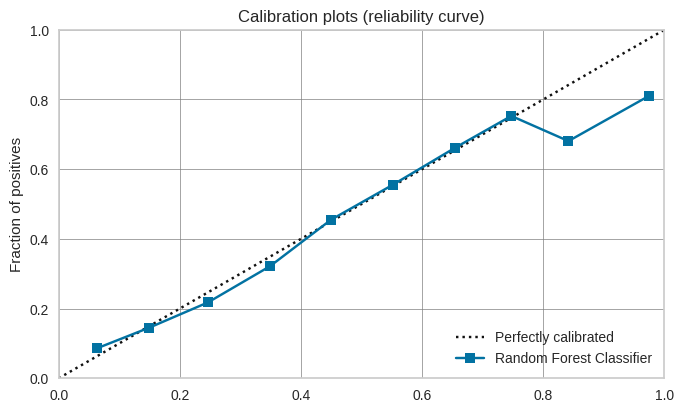

In [40]:
plot_model(rf, plot='calibration')

In [41]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8089,0.7679,0.3066,0.6294,0.4123,0.3141,0.3431
1,0.8296,0.7646,0.3725,0.7104,0.4887,0.3982,0.4281
2,0.8189,0.7697,0.3066,0.6948,0.4254,0.3366,0.3764
3,0.8208,0.7672,0.3639,0.6649,0.4704,0.3734,0.3981
4,0.8189,0.7715,0.3266,0.6786,0.4410,0.3484,0.3816
5,0.8271,0.7781,0.3639,0.7017,0.4792,0.3878,0.4179
6,0.8189,0.7665,0.3266,0.6786,0.4410,0.3484,0.3816
7,0.8264,0.7471,0.3352,0.7222,0.4579,0.3707,0.4095
8,0.8127,0.7531,0.3209,0.6437,0.4283,0.3309,0.3597
9,0.8188,0.7642,0.3362,0.6686,0.4474,0.3529,0.3828


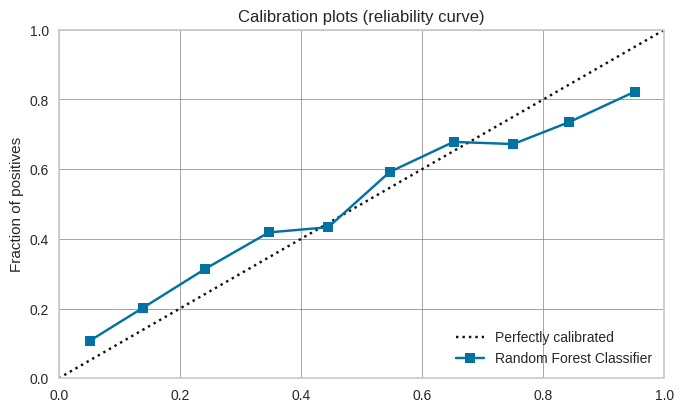

In [42]:
plot_model (calibrated_rf, plot="calibration")

Notice how different the above 2 plots look. One is before calibration and one is after. A perfectly calibrated classifier will follow the black dotted line in the above plots. Not only is calibrated_rf better calibrated but the AUC has also improved from 0.7344 to 0.7702. By default, calibrate_model() uses the sigmoid method which corresponds to Platt's approach. The other available method is isotonic which is a non-parametric approach. See an example of calibration using the isotonic method below:

In [43]:
calibrated_rf_isotonic =  calibrate_model(rf, method="isotonic")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8120,0.7678,0.3352,0.6324,0.4382,0.3379,0.3625
1,0.8321,0.7628,0.4011,0.7035,0.5109,0.4186,0.4427
2,0.8170,0.7704,0.3066,0.6815,0.4229,0.3323,0.3699
3,0.8221,0.7663,0.3725,0.6667,0.4779,0.3809,0.4044
4,0.8195,0.7720,0.3410,0.6723,0.4525,0.3580,0.3876
5,0.8283,0.7761,0.3782,0.6984,0.4907,0.3983,0.4254
6,0.8177,0.7636,0.3410,0.6611,0.4499,0.3537,0.3816
7,0.8283,0.7453,0.3553,0.7168,0.4751,0.3861,0.4202
8,0.8127,0.7537,0.3324,0.6374,0.4369,0.3376,0.3634
9,0.8169,0.7649,0.3506,0.6489,0.4552,0.3568,0.3812


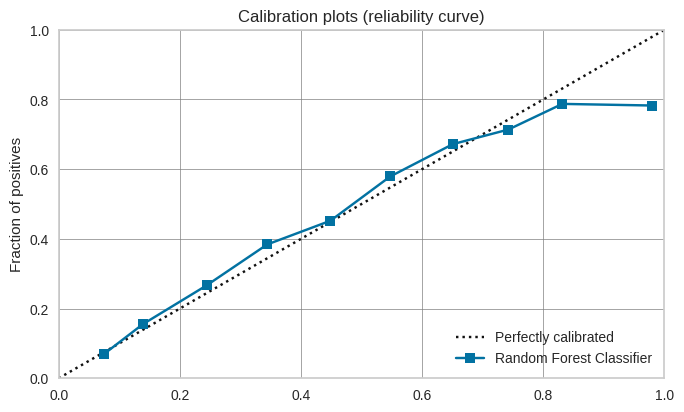

In [44]:
plot_model (calibrated_rf_isotonic, plot="calibration"   )

The accuracy on the hold-out sample is 0.8142 compared with the CV results of 0.8204 in section 9.4 above. Note that there is a significant decline in the AUC on the hold-out set from the CV. We will discuss the reasons for this and how to investigate them in our next tutorial. Binary Classification Tutorial (CLF103) - Level Expert. For now we will finish the remaining part of this experiment using the stacking ensembler stored in the stack_soft variable.

We have covered a lot of new concepts in this tutorial. Most importantly we have seen how to use exploratory data analysis to customize a pipeline in setup() which has improved the results considerably when compared to what we saw earlier in Binary Classification Tutorial (CLF101) - Level Beginner. We have also learned how to perform and tune ensembling in PyCaret.

There are however a few more advanced things to cover in pycaret.classification which include defining and optimizing custom cost functions, interpreting more complex tree based models using shapley values, advanced ensembling techniques such as multiple layer stacknet and more pre-processing pipeline methods. We will cover all of this in our next and final tutorial in the pycaret.classification series.